In [1]:
import logging

from absl import app
from absl import flags
import apache_beam as beam
import xarray as xr
import xarray_beam as xbeam
import xee

import ee
import geemap

In [2]:
import os
import xarray as xr
import geopandas as gp
import pandas as pd
import numpy as np
import sparse

import hvplot.pandas
import hvplot.xarray
import dask
import cf_xarray

from pynhd import NLDI, WaterData
import intake
import cartopy.crs as ccrs
from shapely.geometry import Polygon

import time
import dask
import requests
from dask.distributed import Client

import requests
from IPython.display import HTML
import warnings
from IPython.display import HTML

from pynhd import NLDI, WaterData
import matplotlib.pyplot as plt
import geopandas as gpd
import contextily as ctx

warnings.filterwarnings("ignore", category=FutureWarning, module="geopandas")

In [3]:
geemap.ee_initialize()
ee.Initialize()

In [13]:
dataset = ee.ImageCollection("OREGONSTATE/PRISM/AN81d").filterDate("2010-01-01", "2020-12-31")
ds = geemap.ee_to_xarray(dataset, crs="EPSG:4326", scale=0.25)
ds


<xarray.Dataset>
Dimensions:  (time: 4017, lon: 1440, lat: 720)
Coordinates:
  * time     (time) datetime64[ns] 2010-01-01T12:00:00 ... 2020-12-30T12:00:00
  * lon      (lon) float64 -179.9 -179.6 -179.4 -179.1 ... 179.4 179.6 179.9
  * lat      (lat) float64 -89.88 -89.62 -89.38 -89.12 ... 89.38 89.62 89.88
Data variables:
    ppt      (time, lon, lat) float32 ...
    tmean    (time, lon, lat) float32 ...
    tmin     (time, lon, lat) float32 ...
    tmax     (time, lon, lat) float32 ...
    tdmean   (time, lon, lat) float32 ...
    vpdmin   (time, lon, lat) float32 ...
    vpdmax   (time, lon, lat) float32 ...
Attributes: (12/20)
    date_range:               [347155200000, 1647648000000]
    description:              <p>The PRISM daily and monthly datasets are gri...
    keywords:                 ['climate', 'daily', 'geophysical', 'oregonstat...
    period:                   1
    period_mapping:           [347155200000, 1647648000000]
    product_tags:             ['precipitation', 'climate', 'weather', 'temper...
    ...                       ...
    visualization_0_bands:    ppt
    visualization_0_max:      50.0
    visualization_0_min:      0.0
    visualization_0_name:     Precipitation
    visualization_0_palette:  red,yellow,green,cyan,purple
    crs:                      EPSG:4326

In [14]:
ds = ds.chunk({'time': 10})

ds = ds.metpy.parse_cf()

print("done")
ds

done


<xarray.Dataset>
Dimensions:    (time: 4017, lon: 1440, lat: 720)
Coordinates:
  * time       (time) datetime64[ns] 2010-01-01T12:00:00 ... 2020-12-30T12:00:00
  * lon        (lon) float64 -179.9 -179.6 -179.4 -179.1 ... 179.4 179.6 179.9
  * lat        (lat) float64 -89.88 -89.62 -89.38 -89.12 ... 89.38 89.62 89.88
    metpy_crs  object Projection: latitude_longitude
Data variables:
    ppt        (time, lon, lat) float32 dask.array<chunksize=(10, 1440, 720), meta=np.ndarray>
    tmean      (time, lon, lat) float32 dask.array<chunksize=(10, 1440, 720), meta=np.ndarray>
    tmin       (time, lon, lat) float32 dask.array<chunksize=(10, 1440, 720), meta=np.ndarray>
    tmax       (time, lon, lat) float32 dask.array<chunksize=(10, 1440, 720), meta=np.ndarray>
    tdmean     (time, lon, lat) float32 dask.array<chunksize=(10, 1440, 720), meta=np.ndarray>
    vpdmin     (time, lon, lat) float32 dask.array<chunksize=(10, 1440, 720), meta=np.ndarray>
    vpdmax     (time, lon, lat) float32 dask.array<chunksize=(10, 1440, 720), meta=np.ndarray>
Attributes: (12/20)
    date_range:               [347155200000, 1647648000000]
    description:              <p>The PRISM daily and monthly datasets are gri...
    keywords:                 ['climate', 'daily', 'geophysical', 'oregonstat...
    period:                   1
    period_mapping:           [347155200000, 1647648000000]
    product_tags:             ['precipitation', 'climate', 'weather', 'temper...
    ...                       ...
    visualization_0_bands:    ppt
    visualization_0_max:      50.0
    visualization_0_min:      0.0
    visualization_0_name:     Precipitation
    visualization_0_palette:  red,yellow,green,cyan,purple
    crs:                      EPSG:4326

In [15]:
ds = ds.rename({'lon': 'x', 'lat': 'y'})
ds.hvplot(x='x', y='y', rasterize=True, cmap='viridis', frame_width=600, tiles='OpenTopoMap', title='Annual average precipitation in mm (2010-2020) PRISM', alpha=0.5)

:DynamicMap   [time]
   :Overlay
      .Tiles.I :Tiles   [x,y]
      .Image.I :Image   [x,y]   (ppt)

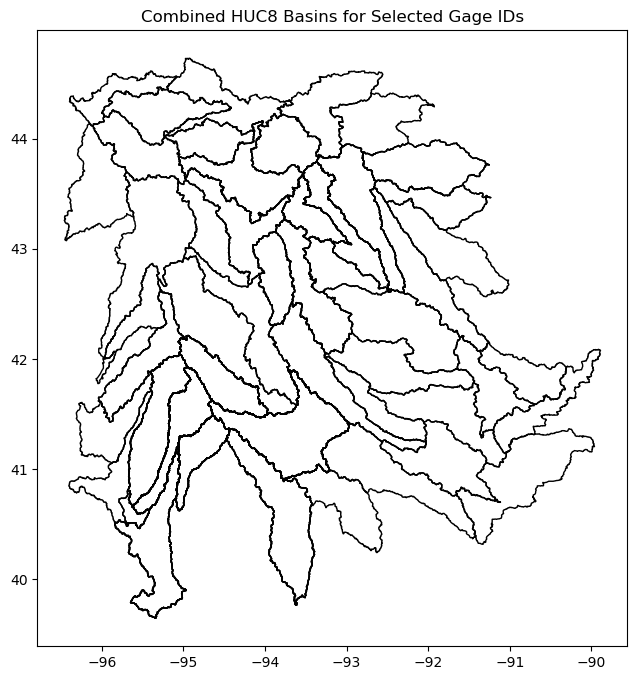

CPU times: total: 28.1 s
Wall time: 30.2 s


,geometry,tnmid,metasourceid,sourcedatadesc,sourceoriginator,sourcefeatureid,loaddate,gnis_id,areaacres,areasqkm,states,huc8,name,globalid
0,"MULTIPOLYGON (((-92.49978 43.62638, -92.49858 ...",{342979AC-90B2-4197-A662-8F96F2E3F98B},None,None,None,None,2012-06-11T07:54:56Z,None,639677.18,2588.68,"IA,MN",07060002,Upper Iowa,{D1E1D77D-2A7E-4DDF-B90F-18865C25B5FB}
1,"MULTIPOLYGON (((-92.20766 43.45717, -92.20740 ...",{5F37CEFE-0361-453D-BE80-A71DB9CD1EF6},None,None,None,None,2012-06-11T07:54:56Z,None,1084109.94,4387.24,IA,07060004,Turkey,{75E01900-FBB8-4E8A-88DD-1F9A3BC58AEF}
2,"MULTIPOLYGON (((-92.99137 43.95035, -92.99055 ...",{6AE5D8A8-3316-49A6-B484-84B00A70076D},None,None,None,None,2012-06-11T07:54:56Z,None,1078114.47,4362.98,"IA,MN",07080201,Upper Cedar,{259068D1-22E3-4C64-BAF0-DF508E1BF5B4}
3,"MULTIPOLYGON (((-91.85773 43.98620, -91.85592 ...",{7598E13E-2260-492E-9B43-ECFD7EBC0B11},None,None,None,None,2017-02-01T00:52:30Z,None,1065066.19,4310.17,"IA,MN",07040008,Root,{459C99D0-9807-4500-8C88-4938C6D68AE5}
4,"MULTIPOLYGON (((-92.65361 43.54975, -92.65215 ...",{D3C57FE4-D26B-46B6-B387-EAB1A96A2CF0},None,None,None,None,2012-06-11T07:54:56Z,None,1003377.82,4060.53,"IA,MN",07080102,Upper Wapsipinicon,{0FFC5DCE-0EC4-41FE-B4E1-440F7BE6546F}
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
88,"MULTIPOLYGON (((-91.99138 41.44409, -91.98991 ...",{D6567D53-25C9-4F9D-9848-7A6CD56F39B3},None,None,None,None,2012-06-11T07:54:56Z,None,1045531.64,4231.12,IA,07080107,Skunk,{F09F9D96-A976-4B34-AA1E-6E01B8B0A617}
89,"MULTIPOLYGON (((-93.36043 43.78841, -93.35986 ...",{D911D322-0667-4C87-9505-EC11E48345D3},None,None,None,None,2012-06-11T07:54:56Z,None,691348.09,2797.79,"IA,MN",07080202,Shell Rock,{7A1231C8-EEBA-4676-9D06-C1E04F658922}
90,"MULTIPOLYGON (((-93.75647 43.26474, -93.75607 ...",{ECE669E9-D814-4A42-9574-B61B0BEEF0E1},None,None,None,None,2012-06-11T07:54:56Z,None,931827.10,3770.97,IA,07080207,Upper Iowa,{DCAA8C3B-2731-4C07-914B-EA8DCD3035B2}
91,"MULTIPOLYGON (((-93.21937 42.02337, -93.21912 ...",{F5482012-4FCC-45A0-9DC5-71524F3980F0},None,None,None,None,2012-06-11T07:54:56Z,None,558361.16,2259.61,IA,07080106,North Skunk,{230E46FF-0656-418C-9612-78991A56381F}


In [16]:
%%time
# List of gage IDs
gage_ids = [
    '05387320', '05457440', '05459490','05486490', '05487470', '05487520', '05487980','06809210', '06809500', '06810000', '06811760', '06811800', '05465700',
#     '05387405', '05387440', '05387500', '05388250', '05388310', '05464220', '05470000', '05455700',
#     '05389000', '05389015', '05389400', '05389500', '05411500', '05411600', 
#     '05411850', '05412020', '05412400', '05412500', '05414400', '05414700', 
#     '05416900', '05418400', '05418500', '05420460', '05420500', '05420680', 
#     '05420850', '05421000', '05421740', '05421890', '05422000', '05422405', 
#     '05422410', '05422470', '05422600', '05422620', '05448400', '05449500', 
#     '05450400', '05451080', '05451210', '0545129280', '05451500', '05451700', 
#     '05451770', '05451900', '05451955', '05452000', '05452200', '05452500', 
#     '05453000', '05453100', '05453200', '05453520', '05454000', '05454090', 
#     '05454220', '05454300', '05454500', '05455010', '05455100', '05455230', 
#     '05455500', '05455700', '05457440', '05457700', '05458000', '05458300', 
#     '05458500', '05458900', '05459490', '05459500', '05460100', '05462000', 
#     '05463000', '05463050', '05463500', '05464000', '05464220', '05464315', 
#     '05464420', '05464475', '05464480', '05464500', '05464695', '05464730', 
#     '05464780', '0546494170', '05465000', '05465100', '05465500', '05465700', 
#     '05469350', '05469860', '05469990', '05470000', '05470500', '05471000', 
#     '05471050', '05471200', '05471500', '05472390', '05472500', '05472555', 
#     '05473400', '05473450', '05474000', '05474500', '05476500', '05476590', 
#     '05476735', '05476750', '05478265', '05479000', '05480080', '05480500', 
#     '05480820', '05480930', '05481000', '05481300', '05481510', '05481530', 
#     '05481650', '05481950', '05482000', '05482300', '05482430', '05482500', 
#     '05483318', '05483349', '05483450', '05483600', '05484000', '05484500', 
#     '05484600', '05484650', '05484800', '05484900', '05485500', '05485605', 
#     '05485640', '05486000', '05486490', '05487470', '05487520', '05487980', 
#     '05488110', '05488200', '05488500', '05489000', '05489200', '05489490', 
#     '05489500', '05490500', '06483290', '06483495', '06483500', '06485500', 
#     '06485950', '06599900', '06599950', '06600000', '06600030', '06600100', 
#     '06600500', '06601200', '06602020', '06602190', '06602400', '06605000', 
#     '06605340', '06605750', '06605850', '06606600', '06607200', '06607500', 
#     '06608500', '06609500', '06609560', '06610505', '06807410', '06808500', 
#     '06809210', '06809500', '06810000', '06811760', '06811800', '06811875', 
#     '06816290', '06817000', '06817300', '06819185', '06898000', '06903400', 
#     '06903700', '06903900', '06903990', '06904010', '402351091222701', 
#     '404753091053001', '405256091012601', '412327091031801', '412957090371001', 
#     '413428090241101', '415143091431601', '415236091432401', '421539090252101', 
#     '422958090391101'
]

nldi = NLDI()
all_basins = []

# Iterate over each gage ID to retrieve the basin data
for gage_id in gage_ids:
    try:
        del_basins = nldi.get_basins(gage_id)
        huc8_basins = WaterData('wbd08').bygeom(del_basins.geometry[0])
        all_basins.append(huc8_basins)
    except Exception as e:
        print(f"Error retrieving data for gage ID {gage_id}: {e}")

# Combine all basin data into a single GeoDataFrame
if all_basins:
    combined_basins = gpd.GeoDataFrame(pd.concat(all_basins, ignore_index=True), crs="EPSG:4326")

    # Plot the combined basins
    combined_basins.plot(figsize=(12, 8), edgecolor='k', facecolor='none')
    plt.title('Combined HUC8 Basins for Selected Gage IDs')
    plt.show()
else:
    print("No basins data available to plot.")
combined_basins

<Axes: >

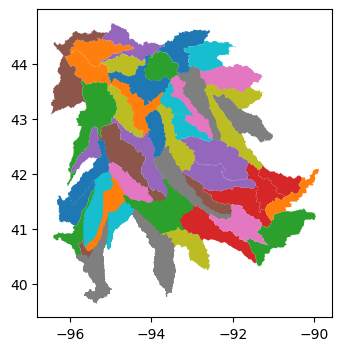

In [17]:
regions_df = combined_basins
region_name = 'name'
regions_df.plot(column=region_name, figsize=(6,4))

In [18]:
crs_orig = f'EPSG:{regions_df.crs.to_epsg()}'
crs_orig

'EPSG:4326'

In [19]:
x = 'x'
y = 'y'

In [20]:
regions_df = regions_df.to_crs('EPSG:4326')
regions_df.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [21]:
bboxc = tuple(regions_df.geometry.bounds.values.flatten())
bbox = tuple(regions_df.total_bounds)
bbox

(-96.461356, 39.644554, -89.88839, 44.731085)

In [24]:
ds = ds.sel(x=slice(bbox[0],bbox[2]), y=slice(bbox[1],bbox[3])).sel(time=slice('2010-01-01','2020-12-31'))
var = 'ppt'
ds

<xarray.Dataset>
Dimensions:    (time: 4017, x: 26, y: 20)
Coordinates:
  * time       (time) datetime64[ns] 2010-01-01T12:00:00 ... 2020-12-30T12:00:00
  * x          (x) float64 -96.38 -96.12 -95.88 -95.62 ... -90.62 -90.38 -90.12
  * y          (y) float64 39.88 40.12 40.38 40.62 ... 43.88 44.12 44.38 44.62
    metpy_crs  object Projection: latitude_longitude
Data variables:
    ppt        (time, x, y) float32 dask.array<chunksize=(10, 26, 20), meta=np.ndarray>
    tmean      (time, x, y) float32 dask.array<chunksize=(10, 26, 20), meta=np.ndarray>
    tmin       (time, x, y) float32 dask.array<chunksize=(10, 26, 20), meta=np.ndarray>
    tmax       (time, x, y) float32 dask.array<chunksize=(10, 26, 20), meta=np.ndarray>
    tdmean     (time, x, y) float32 dask.array<chunksize=(10, 26, 20), meta=np.ndarray>
    vpdmin     (time, x, y) float32 dask.array<chunksize=(10, 26, 20), meta=np.ndarray>
    vpdmax     (time, x, y) float32 dask.array<chunksize=(10, 26, 20), meta=np.ndarray>
Attributes: (12/20)
    date_range:               [347155200000, 1647648000000]
    description:              <p>The PRISM daily and monthly datasets are gri...
    keywords:                 ['climate', 'daily', 'geophysical', 'oregonstat...
    period:                   1
    period_mapping:           [347155200000, 1647648000000]
    product_tags:             ['precipitation', 'climate', 'weather', 'temper...
    ...                       ...
    visualization_0_bands:    ppt
    visualization_0_max:      50.0
    visualization_0_min:      0.0
    visualization_0_name:     Precipitation
    visualization_0_palette:  red,yellow,green,cyan,purple
    crs:                      EPSG:4326

ds_subset_daily = ds.resample(time="M", loffset="M").sum()

In [25]:
grid = ds[[var]].drop(['time', var]).reset_coords().load()
grid

<xarray.Dataset>
Dimensions:    (x: 26, y: 20)
Coordinates:
  * x          (x) float64 -96.38 -96.12 -95.88 -95.62 ... -90.62 -90.38 -90.12
  * y          (y) float64 39.88 40.12 40.38 40.62 ... 43.88 44.12 44.38 44.62
Data variables:
    metpy_crs  object Projection: latitude_longitude
Attributes: (12/20)
    date_range:               [347155200000, 1647648000000]
    description:              <p>The PRISM daily and monthly datasets are gri...
    keywords:                 ['climate', 'daily', 'geophysical', 'oregonstat...
    period:                   1
    period_mapping:           [347155200000, 1647648000000]
    product_tags:             ['precipitation', 'climate', 'weather', 'temper...
    ...                       ...
    visualization_0_bands:    ppt
    visualization_0_max:      50.0
    visualization_0_min:      0.0
    visualization_0_name:     Precipitation
    visualization_0_palette:  red,yellow,green,cyan,purple
    crs:                      EPSG:4326

In [26]:
grid = grid.cf.add_bounds([x, y])

In [27]:
points = grid.stack(point=(y,x))

In [28]:
def bounds_to_poly(x_bounds, y_bounds):
    return Polygon([
        (x_bounds[0], y_bounds[0]),
        (x_bounds[0], y_bounds[1]),
        (x_bounds[1], y_bounds[1]),
        (x_bounds[1], y_bounds[0])
    ])


In [29]:
%%time
boxes = xr.apply_ufunc(
    bounds_to_poly,
    points.x_bounds,
    points.y_bounds,
    input_core_dims=[("bounds",),  ("bounds",)],
    output_dtypes=[np.dtype('O')],
    vectorize=True
)

CPU times: total: 15.6 ms
Wall time: 22 ms


In [30]:
grid_df = gp.GeoDataFrame(
    data={"geometry": boxes.values, "y": boxes[y], "x": boxes[x]},
    index=boxes.indexes["point"],
    crs= 'EPSG:4326'
)

In [31]:
crs_area = "EPSG:6931"

regions_df = regions_df.to_crs(crs_area)
grid_df = grid_df.to_crs(crs_area)

grid_df.crs


<Projected CRS: EPSG:6931>
Name: WGS 84 / NSIDC EASE-Grid 2.0 North
Axis Info [cartesian]:
- X[south]: Easting (metre)
- Y[south]: Northing (metre)
Area of Use:
- name: Northern hemisphere.
- bounds: (-180.0, 0.0, 180.0, 90.0)
Coordinate Operation:
- name: US NSIDC EASE-Grid 2.0 North
- method: Lambert Azimuthal Equal Area
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [32]:
overlay = grid_df.overlay(regions_df, keep_geom_type=True)

In [33]:
sparsity = len(overlay) / (len(grid_df) * len(regions_df))
sparsity

0.03240281224152192

In [34]:
overlay.geometry.area.groupby(overlay[region_name]).sum().nlargest(10)/1e6
regions_df.geometry.area.groupby(regions_df[region_name]).sum().nlargest(10)

name
Lake Red Rock       4.428396e+10
Thompson            2.280482e+10
East Nishnabotna    1.785113e+10
Tarkio-Wolf         1.762129e+10
West Nishnabotna    1.710983e+10
South Raccoon       1.472241e+10
Upper Cedar         1.308892e+10
Upper Iowa          1.271931e+10
West Nodaway        1.235462e+10
South Skunk         9.549496e+09
dtype: float64

In [35]:
grid_cell_fraction = overlay.geometry.area.groupby(overlay[region_name]).transform(lambda x: x / x.sum())
grid_cell_fraction

0       0.006675
1       0.024896
2       0.027531
3       0.000268
4       0.005017
          ...   
1562    0.060375
1563    0.007526
1564    0.022105
1565    0.123154
1566    0.061095
Length: 1567, dtype: float64

In [36]:
grid_cell_fraction.groupby(overlay[region_name]).sum()

name
Big Papillion-Mosquito    1.0
Blue Earth                1.0
Boone                     1.0
Boyer                     1.0
Cannon                    1.0
Copperas-Duck             1.0
Cottonwood                1.0
Des Moines Headwaters     1.0
East Fork Des Moines      1.0
East Nishnabotna          1.0
Flint-Henderson           1.0
Keg-Weeping Water         1.0
Lake Red Rock             1.0
Le Sueur                  1.0
Little Sioux              1.0
Lower Cedar               1.0
Lower Des Moines          1.0
Lower Iowa                1.0
Lower Wapsipinicon        1.0
Maple                     1.0
Middle Cedar              1.0
Middle Des Moines         1.0
Middle Iowa               1.0
Middle Minnesota          1.0
Nishnabotna               1.0
North Raccoon             1.0
North Skunk               1.0
Redwood                   1.0
Rock                      1.0
Root                      1.0
Shell Rock                1.0
Skunk                     1.0
South Raccoon             1.0
South

In [37]:
multi_index = overlay.set_index([y, x, region_name]).index

In [38]:
df_weights = pd.DataFrame({"weights": grid_cell_fraction.values}, index=multi_index)
df_weights

weights
y      x       name                      
39.875 -95.625 Tarkio-Wolf       0.006675
       -95.375 Tarkio-Wolf       0.024896
       -95.125 Tarkio-Wolf       0.027531
       -94.875 Tarkio-Wolf       0.000268
40.125 -95.625 Tarkio-Wolf       0.005017
...                                   ...
44.375 -93.875 Middle Minnesota  0.060375
       -93.625 Middle Minnesota  0.007526
44.625 -95.125 Middle Minnesota  0.022105
       -94.875 Middle Minnesota  0.123154
       -94.625 Middle Minnesota  0.061095

[1567 rows x 1 columns]

In [39]:
ds_weights = xr.Dataset(df_weights)

In [40]:
weights_sparse = ds_weights.unstack(sparse=True, fill_value=0.).weights

In [41]:
def apply_weights_matmul_sparse(weights, data):
    assert isinstance(weights, sparse.SparseArray)
    assert isinstance(data, np.ndarray)
    data = sparse.COO.from_numpy(data)
    data_shape = data.shape
    n, k = data_shape[0], data_shape[1] * data_shape[2]
    data = data.reshape((n, k))
    weights_shape = weights.shape
    k_, m = weights_shape[0] * weights_shape[1], weights_shape[2]
    assert k == k_
    weights_data = weights.reshape((k, m))
    regridded = sparse.matmul(data, weights_data)
    assert regridded.shape == (n, m)
    return regridded.todense()

In [42]:
%%time
with dask.config.set(**{'array.slicing.split_large_chunks': False}):
    var_regridded = xr.apply_ufunc(
        apply_weights_matmul_sparse,
        weights_sparse,
        ds[var],
        join="left",
        input_core_dims=[[y, x, region_name], [y, x]],
        output_core_dims=[[region_name]],
        dask="parallelized",
        dask_gufunc_kwargs=dict(meta=[np.ndarray((0,))])
    )
    
var_regridded.compute()

CPU times: total: 24.3 s
Wall time: 1min 10s


<xarray.DataArray (time: 4017, name: 48)>
array([[7.93006319e-05, 0.00000000e+00, 0.00000000e+00, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [3.60933554e+00, 0.00000000e+00, 0.00000000e+00, ...,
        1.55888711e+00, 0.00000000e+00, 6.19253789e-02],
       [5.84309196e-02, 0.00000000e+00, 0.00000000e+00, ...,
        1.51411468e-04, 0.00000000e+00, 0.00000000e+00],
       ...,
       [2.17856522e+00, 5.84506176e-03, 0.00000000e+00, ...,
        2.04191728e-01, 1.35856678e-03, 3.14414898e-03],
       [1.14042165e+01, 2.87899362e+00, 6.78032770e+00, ...,
        1.94103391e+01, 3.98794383e+00, 2.56693472e+00],
       [0.00000000e+00, 1.14893025e-02, 0.00000000e+00, ...,
        0.00000000e+00, 4.40464701e-03, 5.80978380e-05]])
Coordinates:
  * name       (name) object 'Big Papillion-Mosquito' 'Blue Earth' ... 'Zumbro'
  * time       (time) datetime64[ns] 2010-01-01T12:00:00 ... 2020-12-30T12:00:00
    metpy_crs  object Projection: latitude_longitude

In [43]:
var_regridded

<xarray.DataArray (time: 4017, name: 48)>
dask.array<transpose, shape=(4017, 48), dtype=float64, chunksize=(10, 48), chunktype=numpy.ndarray>
Coordinates:
  * name       (name) object 'Big Papillion-Mosquito' 'Blue Earth' ... 'Zumbro'
  * time       (time) datetime64[ns] 2010-01-01T12:00:00 ... 2020-12-30T12:00:00
    metpy_crs  object Projection: latitude_longitude

In [44]:
# df_mean = var_regridded.to_pandas().sum()
# .sel(name=['Upper Cedar','Upper Iowa'])
df_mean = var_regridded.resample(time="Y").sum().to_pandas().mean()
df_mean.name = var
df_mean = pd.DataFrame(df_mean).reset_index()
print(df_mean.columns)

Index(['name', 'ppt'], dtype='object')


In [45]:
print(regions_df.columns)

Index(['geometry', 'tnmid', 'metasourceid', 'sourcedatadesc',
       'sourceoriginator', 'sourcefeatureid', 'loaddate', 'gnis_id',
       'areaacres', 'areasqkm', 'states', 'huc8', 'name', 'globalid'],
      dtype='object')


In [46]:
merged = pd.merge(regions_df, df_mean)

# # Check the merged DataFrame
# print(merged.head())

In [47]:
crs_geo = 'EPSG:4326'

merged_geo = merged.to_crs(crs_geo)

In [48]:
# Plot all pixels

# CartoDark', 'CartoEco', 'CartoLight', 'CartoMidnight', 'EsriAntarcticImagery', 'EsriArcticImagery', 'EsriArcticOceanBase', 'EsriArcticOceanReference', 'EsriDelormeWorldBaseMap', 'EsriImagery', 'EsriNatGeo', 'EsriOceanBase', 'EsriOceanReference', 'EsriReference', 'EsriTerrain', 'EsriUSATopo', 'EsriWorldBoundariesAndPlaces', 'EsriWorldBoundariesAndPlacesAlternate', 'EsriWorldDarkGrayBase', 'EsriWorldDarkGrayReference', 'EsriWorldHillshade', 'EsriWorldHillshadeDark', 'EsriWorldLightGrayBase', 'EsriWorldLightGrayReference', 'EsriWorldNavigationCharts', 'EsriWorldPhysical', 'EsriWorldShadedRelief', 'EsriWorldStreetMap', 'EsriWorldTopo', 'EsriWorldTransportation', 'OSM', 'OpenTopoMap'
merged_geo.hvplot(c=var, geo=True, cmap='viridis_r', frame_width=600, tiles='EsriWorldTopo', title='Annual average precipitation in mm (2010-2020) PRISM', alpha=0.5)

:Overlay
   .WMTS.I     :WMTS   [Longitude,Latitude]
   .Polygons.I :Polygons   [Longitude,Latitude]   (ppt)

def main():
    # Authenticate and initialize Earth Engine
    ee.Initialize()

    # Create and filter the dataset
    dataset = ee.ImageCollection("IDAHO_EPSCOR/GRIDMET").filterDate("2010-01-01", "2020-12-31")
    
    # Function to download data in smaller chunks
    def download_chunk(start_date, end_date):
        chunk = dataset.filterDate(start_date, end_date)
        ds_chunk = geemap.ee_to_xarray(chunk, crs="EPSG:4326", scale=0.25)
        return ds_chunk
    
    # Define time chunks (e.g., yearly chunks)
    time_chunks = [
        ('2010-01-01', '2010-12-31'),
        ('2011-01-01', '2011-12-31'),
        ('2012-01-01', '2012-12-31'),
        ('2013-01-01', '2013-12-31'),
        ('2014-01-01', '2014-12-31'),
        ('2015-01-01', '2015-12-31'),
        ('2016-01-01', '2016-12-31'),
        ('2017-01-01', '2017-12-31'),
        ('2018-01-01', '2018-12-31'),
        ('2019-01-01', '2019-12-31'),
        ('2020-01-01', '2020-12-31')
    ]
    
    # Download and store chunks
    chunks = [download_chunk(start, end) for start, end in time_chunks]
    
    # Combine chunks into a single xarray Dataset
    ds = xr.concat(chunks, dim='time')
    
    # Save the xarray dataset to a NetCDF file for use with Intake
    ds.to_netcdf("gridmet_data.nc")

    # Create an Intake catalog that references the NetCDF file
    catalog_content = """
    sources:
      gridmet:
        driver: netcdf
        args:
          urlpath: "gridmet_data.nc"
    """

    with open('catalog.yml', 'w') as f:
        f.write(catalog_content)

    # Load the catalog
    cat = intake.open_catalog('catalog.yml')

    # Load the dataset using Dask and parse CF conventions using MetPy
    ds_dask = cat['gridmet'].to_dask().metpy.parse_cf()

    print("done")
    return ds_dask

if __name__ == '__main__':
    ds_dask = main()
    print(ds_dask)